# How Well Can We Automatically Detect If People Are Wearing Masks Properly?

With the ongoing state of the COVID-19 pandemic, one of the primary lines of defense we have is wearing masks to slow the airborne spread of the virus. This, of course, will only protect if masks are worn properly by individuals. Often, individuals can be seen wearing masks that do not fully cover the nose or the mouth - which is completely defeating of the purpose of wearing masks.

Currently, proper mask wearing can only be enforced by if a human can identify if someone is wearing the mask properly or not. This allows for many opportunites for human error, a lack of care about enforecement, and an inability to see everyone all the time. All those factors will increase virus spread and prolong the pandemic.

The issues that could arise with a purely human based mask checking system pose an interesting question - could we do this process automatically? If such checking could be done automatically, the enforcement of proper masking wearing would become much more effective, and the spread of COVID-19 would decrease.

This project will explore the possibility of developing the early stages of an automatic mask checking system. We will create a machine learning model which will learn based on images of those who are wearing masks both properly and improperly.

If the performance of such a model proves to be effective, this project can be developed into a program where cameras scan entire rooms for mask enforcement.

### Project software depedencies
For the code in this project to run properly, the libraries below must be installed. Please follow the links for any assistance in library installation.
- numpy: https://numpy.org/install/
- cv2: https://pypi.org/project/opencv-python/
- matplotlib: https://matplotlib.org/stable/
- tensorflow: https://www.tensorflow.org/install

## Import Necessary Libaries

We will have to import the necessary libraries in order to access/process/manipulate/display our data and create/train our neural network.

In [1]:
# Import os to access locally saved image data
import os

# Import numpy be able to test our model agaisnt unseen test data
import numpy as np

# Import cv2 to process images
import cv2

# Import matplotlib to display images in notebook
import matplotlib.pyplot as plt

# Import tensorflow library and functions to manipulate image data and create neural network
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Import random to set seed for python (needed for reproducability of model results)
import random as rn

In order to have reproducible results, we will set the seed for the python, numpy, and tensorflow.

In [2]:
seed = 0

# Sets seed for the python hash seed
os.environ['PYTHONHASHSEED'] = str(seed)

# Sets seed for numpy
np.random.seed(seed)

# Sets seed for python
rn.seed(seed)

# Sets seed for tensorflow
tf.random.set_seed(seed)

## Our Data

Our data is provided [here](https://github.com/cabani/MaskedFace-Net). The MaskedFace-Net dataset is a curation of over 130,000 images, 67,000+ of which are people wearing masks properly, and 66,000+ of which are people wearing masks improperly. Due do processing constraints from only being able to run this model locally, this project will not use all 130,000+ images. With 3795 images in our training set (1912 with proper masks and 1883 with improper masks), 1911 images in our validation set (950 with proper masks and 961 with improper masks), and 1920 images in our testing set (953 with proper masks and 967 with improper masks), the model performance will still be quite impressive.

The images from the original MaskedFace-Net data source were sorted into the appropriate directories to be used for either training, validation, or testing as can be seen in the GitHub.

### Example of an image with a properly worn mask

Masks will be considered properly worn if both the mouth and the nose are competely covered. This is an example of a properly worn mask:

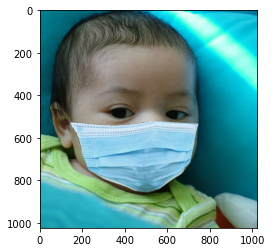

In [3]:
proper_example_file_path = "data/training/proper/00000_Mask.jpg"

img = image.load_img(proper_example_file_path)
plt.imshow(img)

### Example of an image with an improperly worn mask

Masks will be considered properly worn if either the mouth or the nose are not competely covered. This is an example of an improperly worn mask:

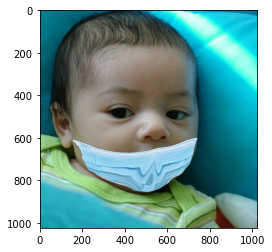

In [4]:
improper_example_file_path = "data/training/non_proper/00000_Mask_Mouth_Chin.jpg"

img = image.load_img(improper_example_file_path)
plt.imshow(img)

## Data Representaion and Manipulation

In order for the network, all of the data must be of the same dimensions. The MaskedFace-Net dataset only provides images of 1024x1024 pixels with RGB values of each pixel. Resulting in a shape of (1024, 1024, 3).

In [5]:
print(cv2.imread(proper_example_file_path).shape)
print(cv2.imread(improper_example_file_path).shape)

(1024, 1024, 3)
(1024, 1024, 3)


Every individual pixel takes the following form of [R, G, B] where each R, G, and B are integers from [0,255]. We will take a step to rescale these RGB values to [0,1] as it will lead to faster convergence in our model training.

In [6]:
cv2.imread(proper_example_file_path)[0][0]

array([148, 135,   3], dtype=uint8)

We will be using the ImageDataGenerator object provided in the tensorflow library to create our training and validation dataset variables which will be used in model training. When creating the objects, we pass in our rescale factor of 1/255 to ensure all RGB values will be [0,1].


As we can see, we have 3795 images in the training set, 1911 images in the validation set, and 1920 images in the test set.

In [7]:
train = ImageDataGenerator(rescale = 1/255)

train_dataset = train.flow_from_directory("data/training/",
                                          target_size = (1024, 1024),
                                          batch_size = 64,
                                          class_mode = 'binary')

Found 3795 images belonging to 2 classes.


In [8]:
validation = ImageDataGenerator(rescale = 1/255)

validation_dataset = train.flow_from_directory("data/validation/",
                                          target_size = (1024, 1024),
                                          batch_size = 64,
                                          class_mode = 'binary')

Found 1911 images belonging to 2 classes.


In [9]:
test = ImageDataGenerator(rescale = 1/255)

test_dataset = train.flow_from_directory("data/test/",
                                          target_size = (1024, 1024),
                                          batch_size = 64,
                                          class_mode = 'binary')

Found 1920 images belonging to 2 classes.


The ImageDataGenerator object will label images of people wearing masks improperly as 0 and images of people wearing masks properly as 1.

In [10]:
print(train_dataset.class_indices)
print(validation_dataset.class_indices)
print(test_dataset.class_indices)

{'non_proper': 0, 'proper': 1}
{'non_proper': 0, 'proper': 1}
{'non_proper': 0, 'proper': 1}


In [11]:
print(train_dataset.classes)
print(validation_dataset.classes)
print(test_dataset.classes)

[0 0 0 ... 1 1 1]
[0 0 0 ... 1 1 1]
[0 0 0 ... 1 1 1]


## Modeling

Now that our data is in the proper structure for modeling, we will create and train a neural network. When trying to train a model to classify images, it is extremely useful to maintatin spatial information about the image. This is where convolutional nerual networks come into play. Convoluional layers in neural networks will have a filter pass over all the pixels and create a "simplified" representation of the image as an output. Following every convolutional layer in our neural network, we will have a pooling layer which is meant to reduce the number of feautures in our data and decrease the time/number of layers it takes to train our model.

After our convolutional and pooling layers, we need to flatten the data into linear data. This is done with a flattening layer. Our flattened data is then passed into a fully connected layer and then finally classified using the sigmoid function (which we can do because we are only classifying between two classes). 

In [12]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(16,(3,3),activation='relu',input_shape = (1024,1024,3)),
    tf.keras.layers.MaxPool2D(2,2),
    tf.keras.layers.Conv2D(32,(3,3),activation='relu'),
    tf.keras.layers.MaxPool2D(2,2),
    tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
    tf.keras.layers.MaxPool2D(2,2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512,activation='relu'),
    tf.keras.layers.Dense(1,activation='sigmoid')
])

In [13]:
model.compile(loss = 'binary_crossentropy',
              optimizer = tf.keras.optimizers.RMSprop(lr=.001),
              metrics = ['accuracy'])

After some experimentation, we felt that having 8 epochs of training with 3 steps per epoch provided us with a high level of prediction accuracy in a reasonable amount of training time (~1 hour on a machine with a 2.7 GHz Quad-Core Intel Core i7 processor and 16 GB of RAM).

The final validation accuracy (accuracy on data that the model is not trained on) was ~93% in the final epoch.

In [14]:
model_fit = model.fit(train_dataset,
                      steps_per_epoch = 3,
                      epochs = 8,
                      validation_data = validation_dataset)

Epoch 1/8
3/3 [==============================] - 375s 152s/step - loss: 78.9939 - accuracy: 0.5417 - val_loss: 11.7562 - val_accuracy: 0.5029
Epoch 2/8
3/3 [==============================] - 365s 147s/step - loss: 9.5502 - accuracy: 0.5215 - val_loss: 0.8847 - val_accuracy: 0.5076
Epoch 3/8
3/3 [==============================] - 366s 149s/step - loss: 0.9177 - accuracy: 0.4616 - val_loss: 0.5816 - val_accuracy: 0.7200
Epoch 4/8
3/3 [==============================] - 432s 175s/step - loss: 0.5304 - accuracy: 0.7891 - val_loss: 0.4468 - val_accuracy: 0.8456
Epoch 5/8
3/3 [==============================] - 395s 160s/step - loss: 0.5635 - accuracy: 0.7480 - val_loss: 0.3454 - val_accuracy: 0.8932
Epoch 6/8
3/3 [==============================] - 430s 178s/step - loss: 0.6980 - accuracy: 0.7383 - val_loss: 0.6428 - val_accuracy: 0.6499
Epoch 7/8
3/3 [==============================] - 387s 151s/step - loss: 0.7144 - accuracy: 0.6751 - val_loss: 0.3431 - val_accuracy: 0.9048
Epoch 8/8
3/3 [===

## Performance on Completely Unseen Data

The two directories 'testing_visual' and 'test' were reserved to evalute model performance on completely unseen data once the neural network was trained. The 'testing_visual' directory was created to get a visual sense of how well the model was performing. The 'test' directory was creaed to give a quantifiable measure of accuracy.

In the next cell is results of our model performance visually:

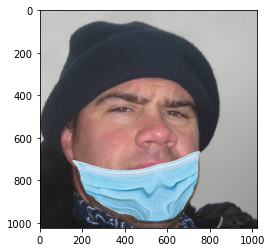

The mask is not worn properly


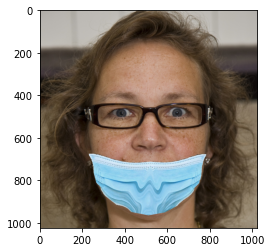

The mask is not worn properly


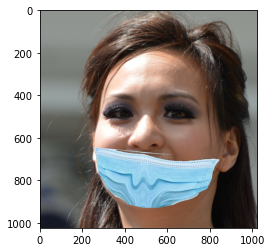

The mask is not worn properly


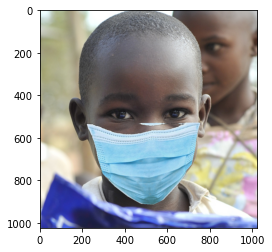

The mask is worn properly


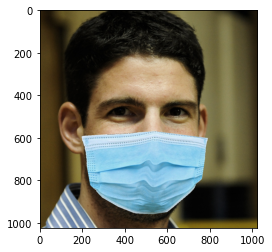

The mask is worn properly


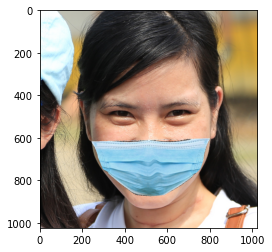

The mask is worn properly


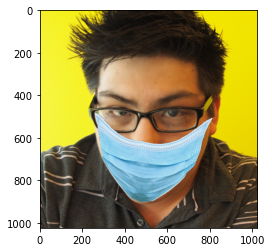

The mask is not worn properly


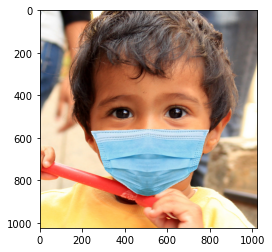

The mask is worn properly


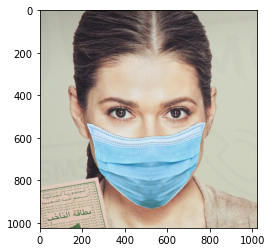

The mask is worn properly


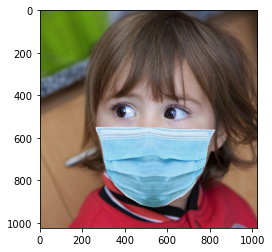

The mask is worn properly


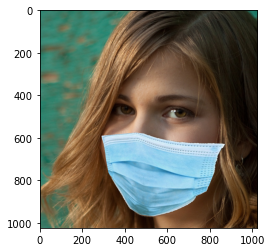

The mask is worn properly


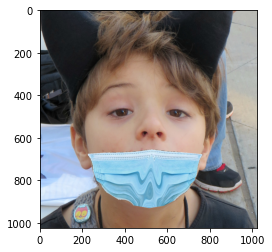

The mask is not worn properly


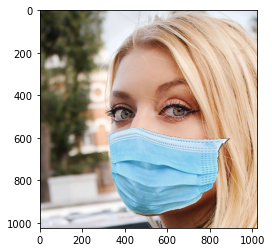

The mask is worn properly


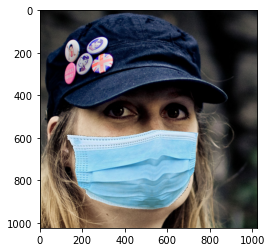

The mask is worn properly


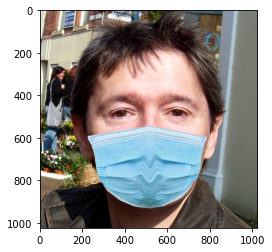

The mask is worn properly


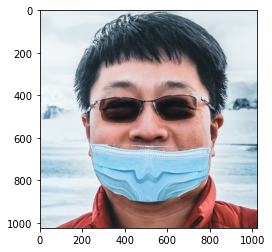

The mask is not worn properly


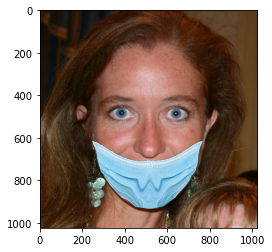

The mask is not worn properly


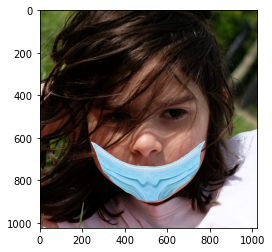

The mask is not worn properly


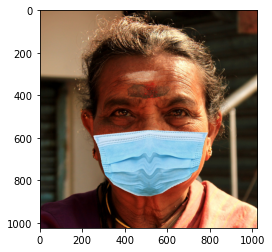

The mask is worn properly


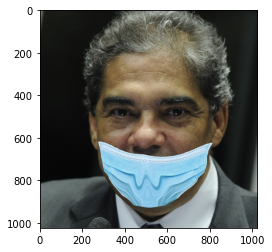

The mask is not worn properly


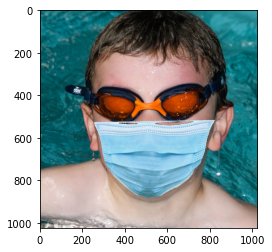

The mask is worn properly


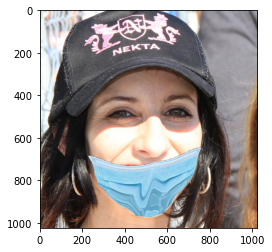

The mask is not worn properly


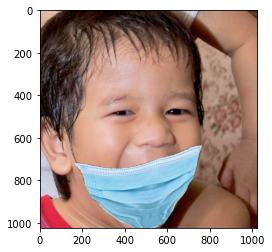

The mask is not worn properly


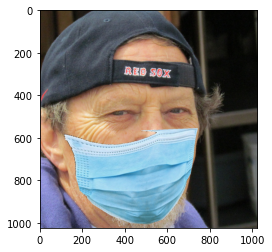

The mask is worn properly


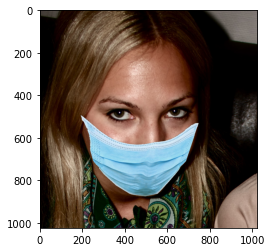

The mask is worn properly


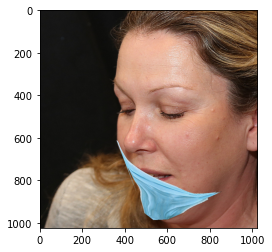

The mask is not worn properly


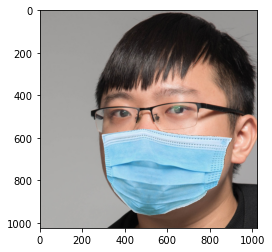

The mask is worn properly


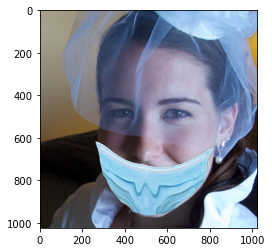

The mask is not worn properly


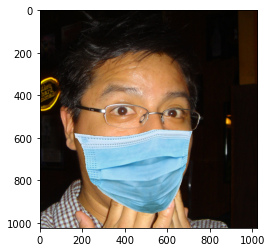

The mask is worn properly


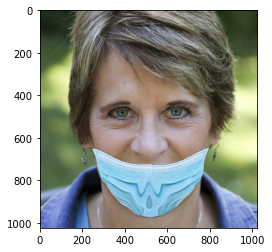

The mask is not worn properly


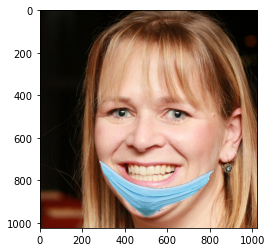

The mask is not worn properly


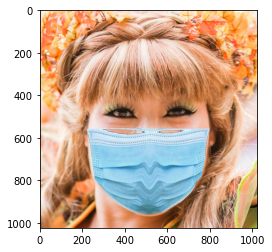

The mask is worn properly


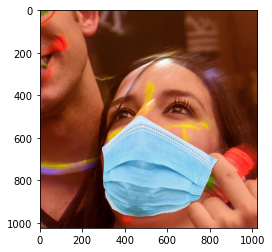

The mask is worn properly


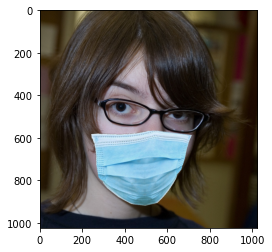

The mask is worn properly


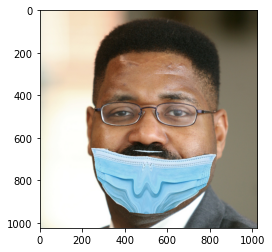

The mask is not worn properly


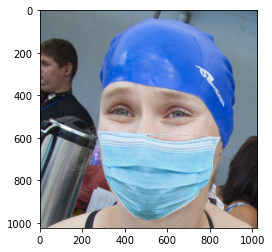

The mask is worn properly


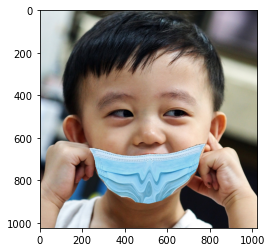

The mask is not worn properly


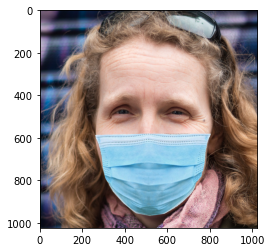

The mask is worn properly


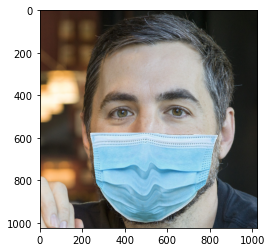

The mask is worn properly


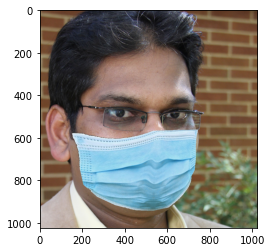

The mask is worn properly


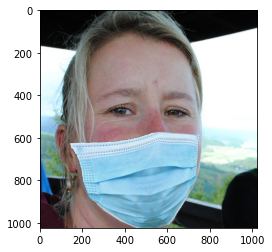

The mask is worn properly


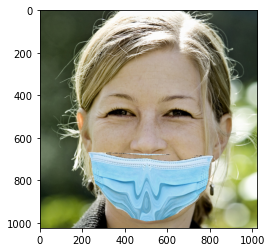

The mask is not worn properly


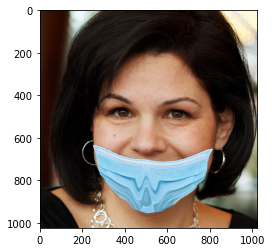

The mask is not worn properly


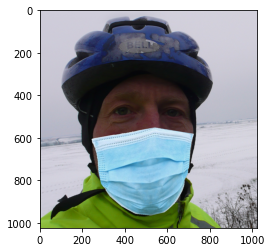

The mask is worn properly


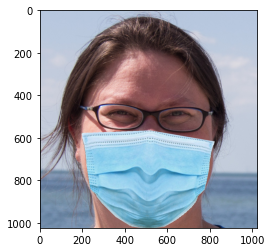

The mask is worn properly


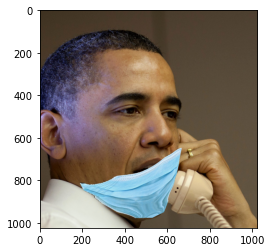

The mask is not worn properly


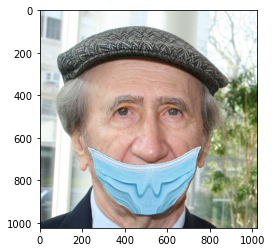

The mask is not worn properly


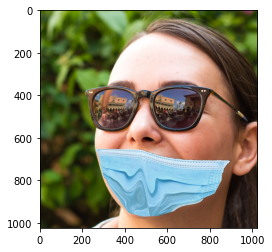

The mask is not worn properly


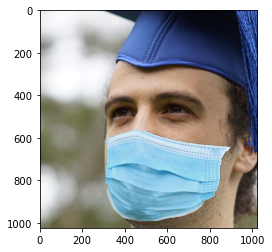

The mask is worn properly


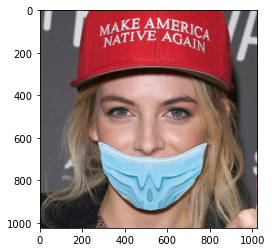

The mask is not worn properly


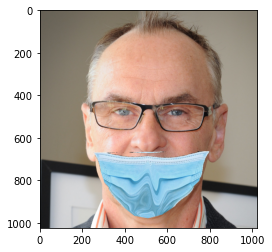

The mask is not worn properly


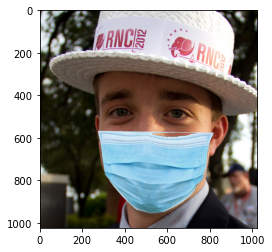

The mask is worn properly


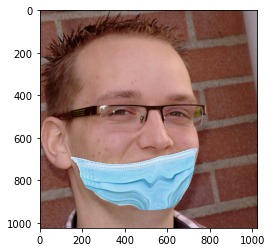

The mask is not worn properly


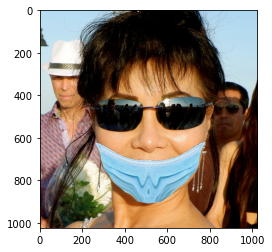

The mask is not worn properly


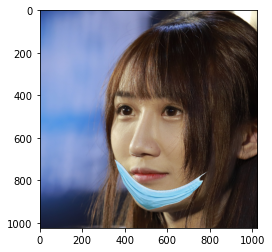

The mask is not worn properly


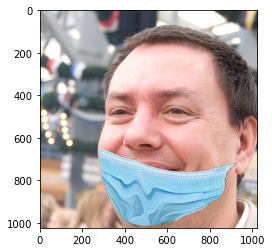

The mask is not worn properly


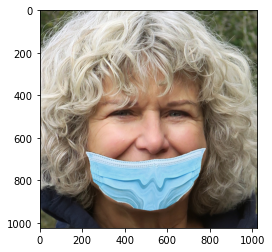

The mask is not worn properly


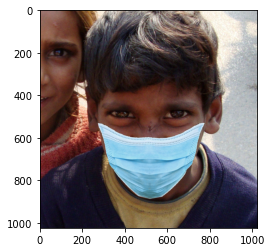

The mask is worn properly


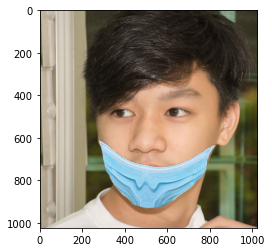

The mask is not worn properly


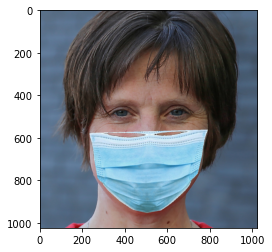

The mask is worn properly


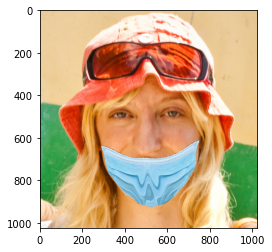

The mask is not worn properly


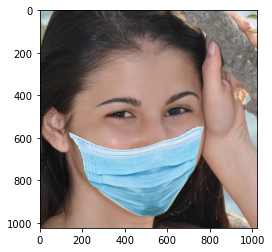

The mask is worn properly


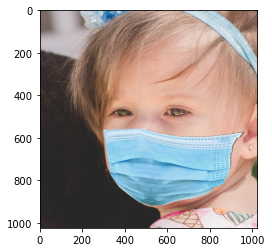

The mask is worn properly


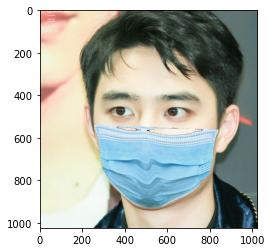

The mask is worn properly


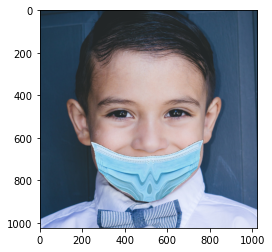

The mask is not worn properly


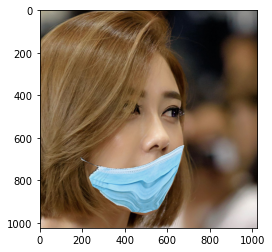

The mask is not worn properly


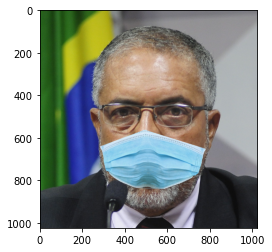

The mask is worn properly


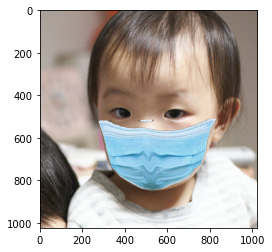

The mask is worn properly


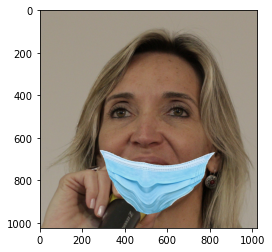

The mask is not worn properly


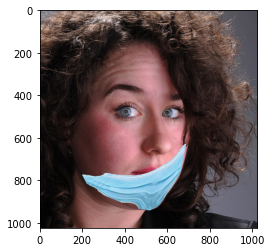

The mask is not worn properly


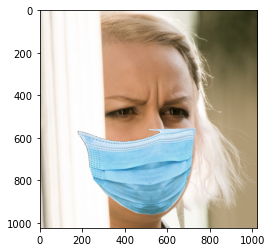

The mask is worn properly


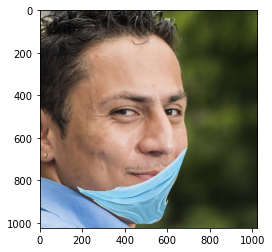

The mask is not worn properly


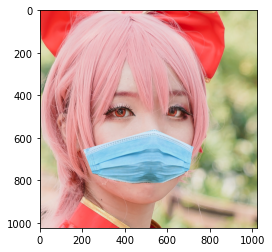

The mask is worn properly


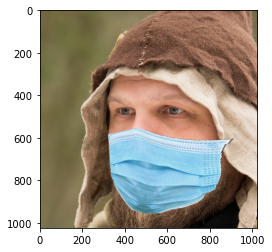

The mask is worn properly


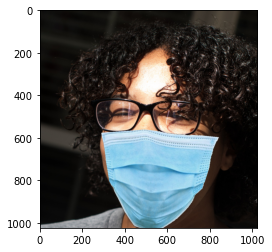

The mask is worn properly


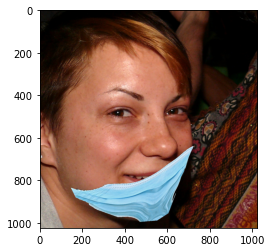

The mask is not worn properly


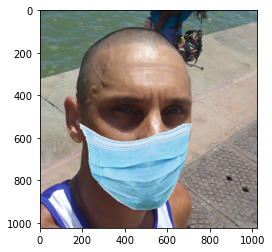

The mask is worn properly


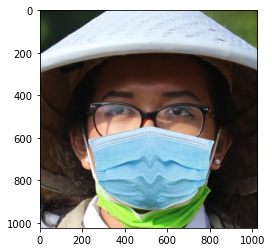

The mask is worn properly


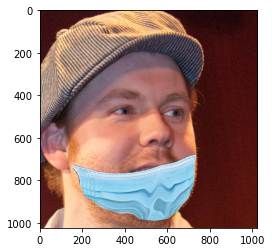

The mask is not worn properly


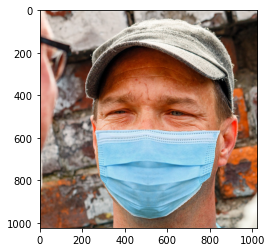

The mask is worn properly


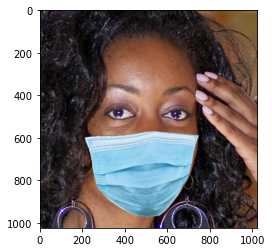

The mask is worn properly


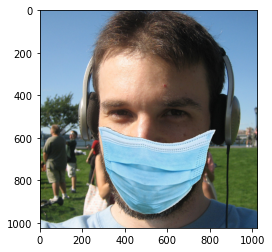

The mask is worn properly


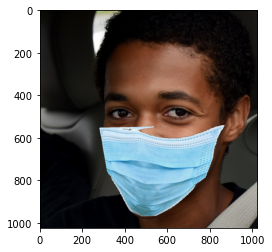

The mask is worn properly


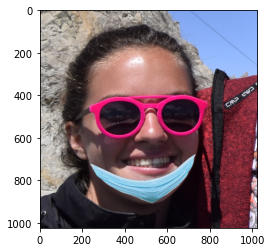

The mask is not worn properly


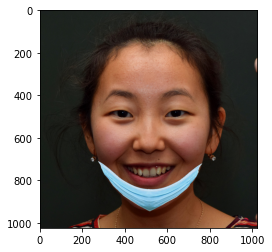

The mask is not worn properly


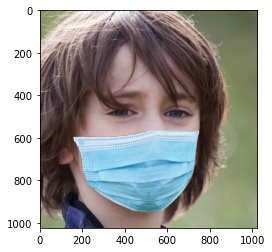

The mask is worn properly


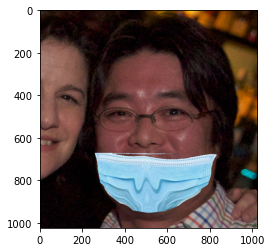

The mask is not worn properly


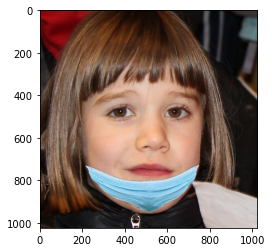

The mask is not worn properly


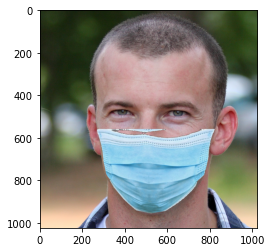

The mask is worn properly


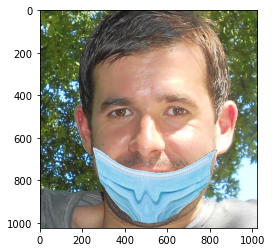

The mask is not worn properly


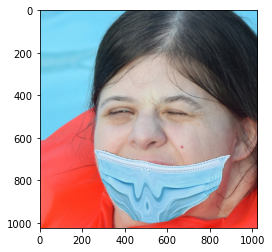

The mask is not worn properly


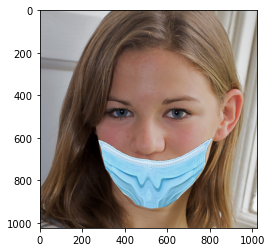

The mask is not worn properly


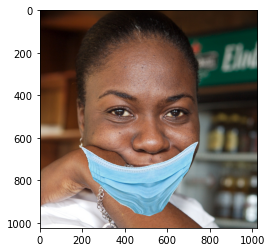

The mask is not worn properly


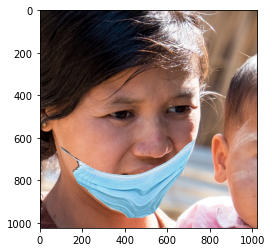

The mask is not worn properly


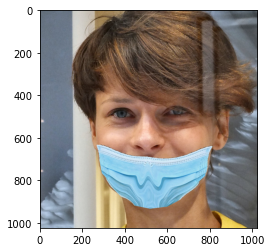

The mask is not worn properly


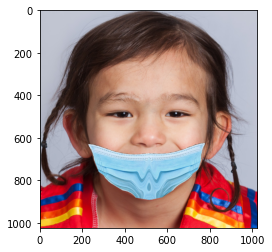

The mask is not worn properly


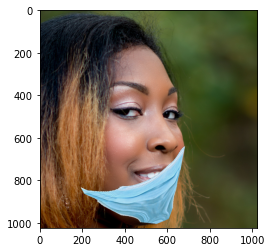

The mask is not worn properly


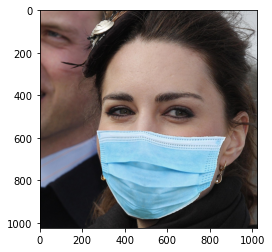

The mask is worn properly


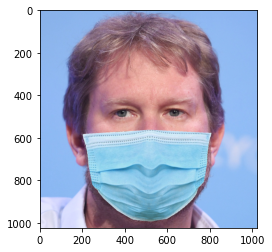

The mask is worn properly


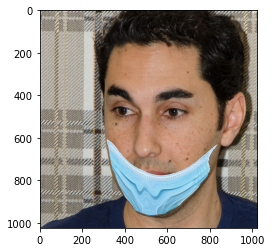

The mask is not worn properly


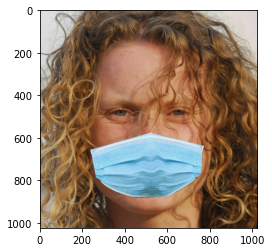

The mask is worn properly


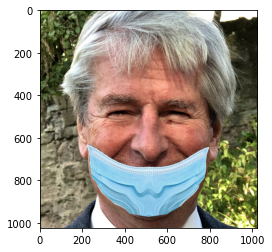

The mask is not worn properly


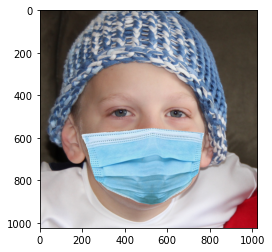

The mask is worn properly


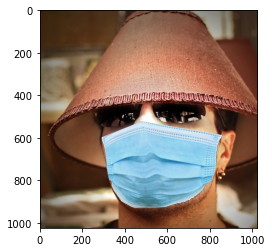

The mask is worn properly


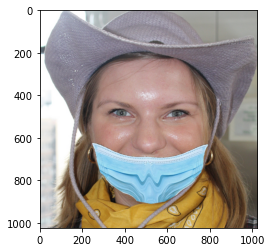

The mask is not worn properly


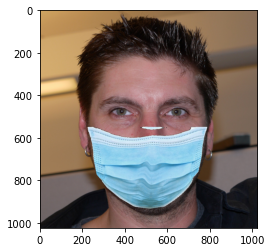

The mask is worn properly


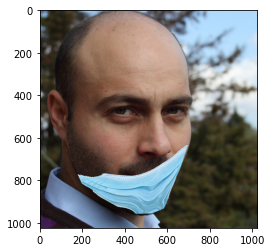

The mask is not worn properly


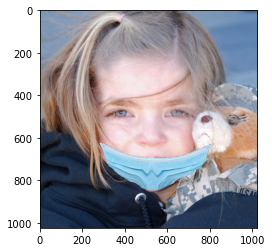

The mask is not worn properly


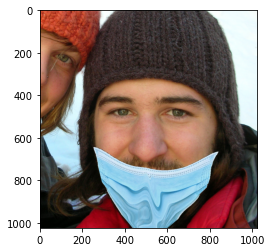

The mask is not worn properly


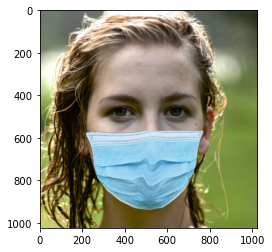

The mask is worn properly


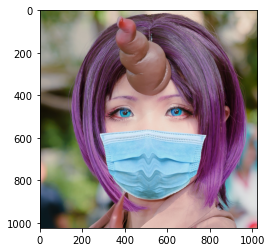

The mask is worn properly


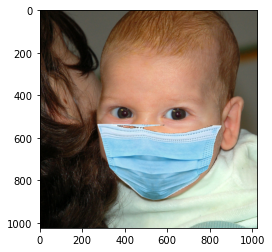

The mask is worn properly


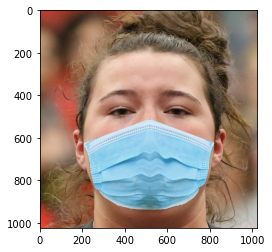

The mask is worn properly


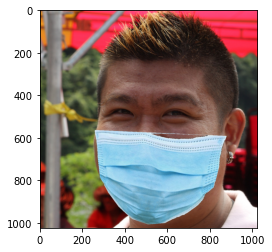

The mask is worn properly


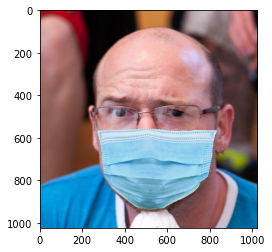

The mask is worn properly


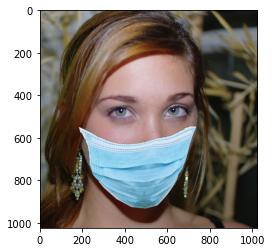

The mask is worn properly


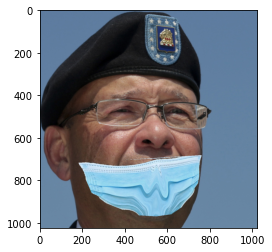

The mask is not worn properly


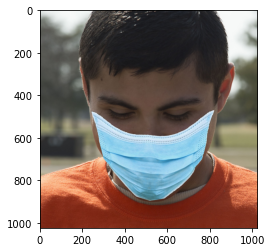

The mask is worn properly


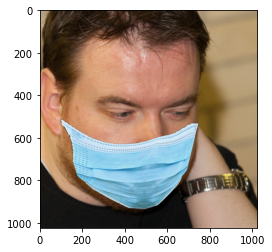

The mask is worn properly


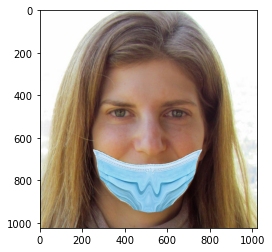

The mask is not worn properly


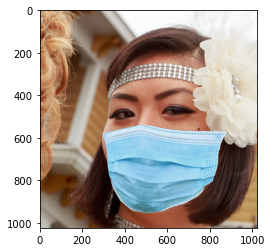

The mask is worn properly


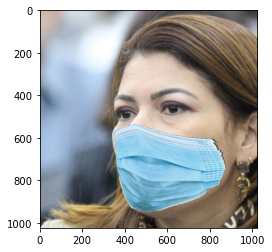

The mask is worn properly


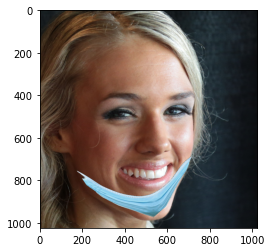

The mask is not worn properly


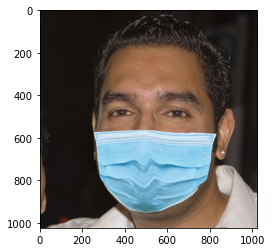

The mask is worn properly


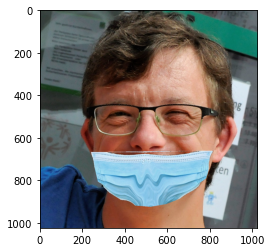

The mask is not worn properly


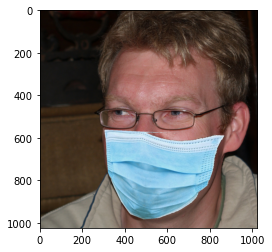

The mask is worn properly


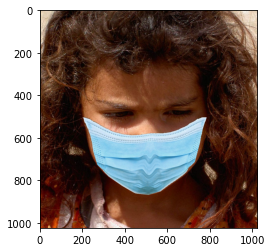

The mask is worn properly


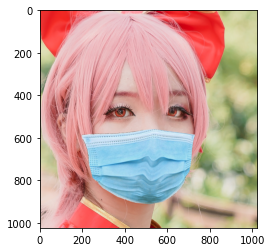

The mask is worn properly


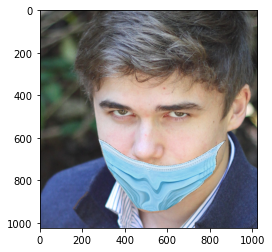

The mask is not worn properly


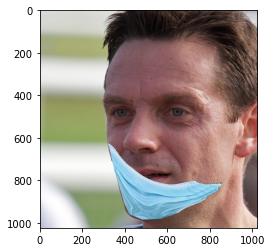

The mask is not worn properly


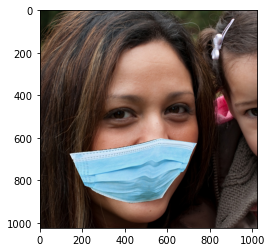

The mask is worn properly


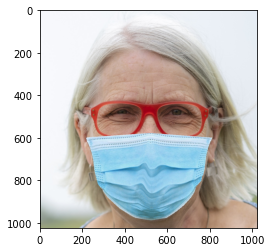

The mask is worn properly


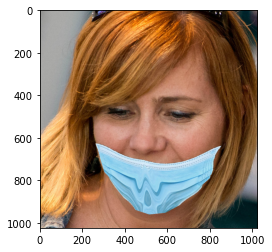

The mask is not worn properly


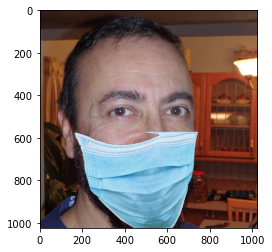

The mask is worn properly


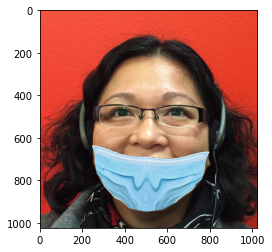

The mask is not worn properly


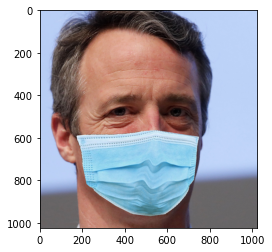

The mask is worn properly


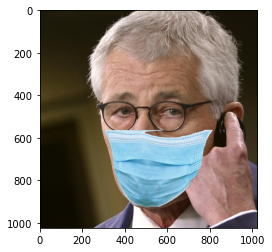

The mask is worn properly


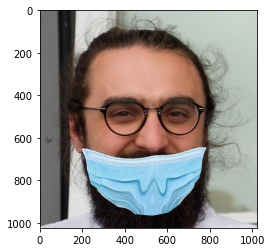

The mask is not worn properly


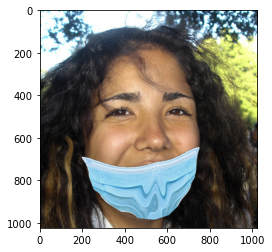

The mask is not worn properly


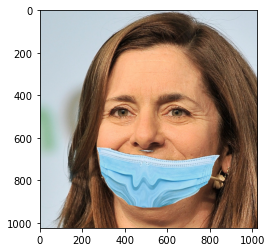

The mask is not worn properly


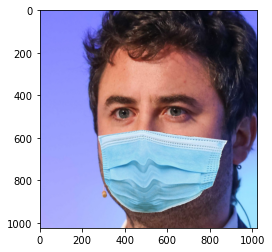

The mask is worn properly


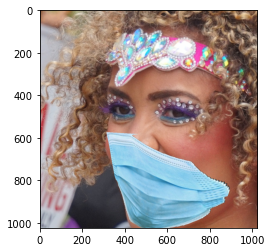

The mask is not worn properly


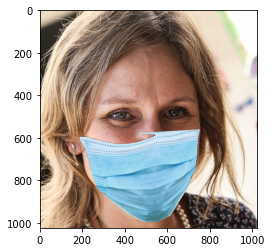

The mask is worn properly


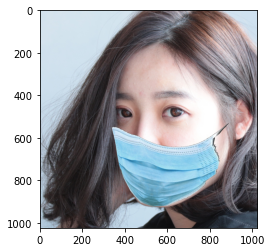

The mask is worn properly


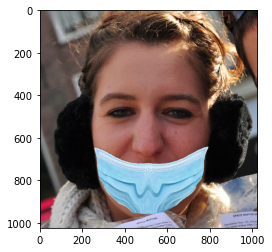

The mask is not worn properly


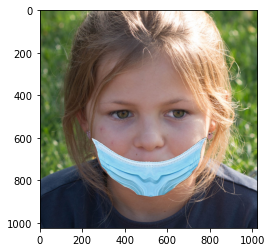

The mask is not worn properly


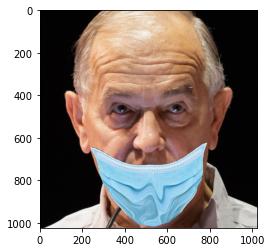

The mask is not worn properly


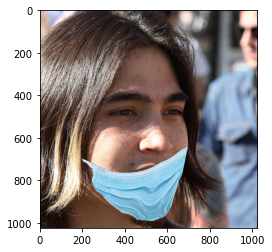

The mask is not worn properly


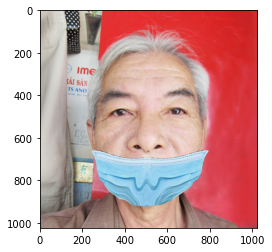

The mask is not worn properly


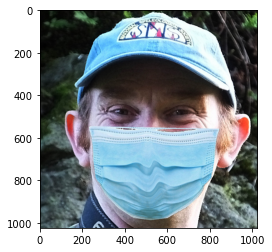

The mask is not worn properly


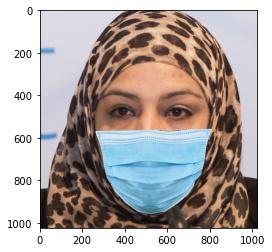

The mask is worn properly


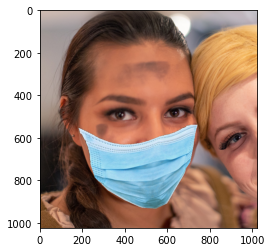

The mask is worn properly


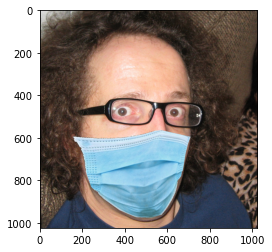

The mask is worn properly


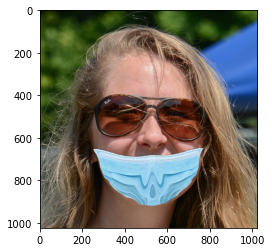

The mask is worn properly


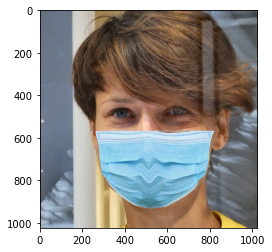

The mask is worn properly


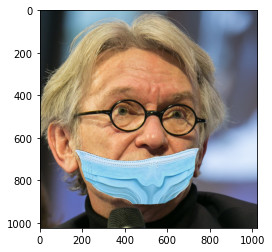

The mask is not worn properly


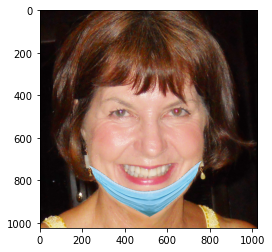

The mask is not worn properly


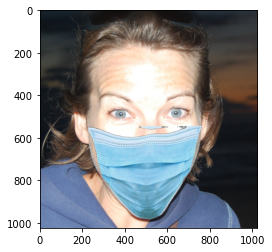

The mask is worn properly


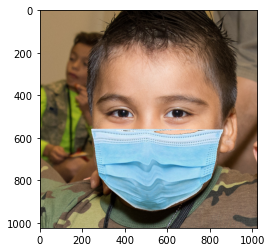

The mask is worn properly


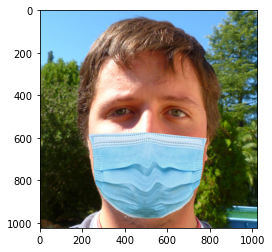

The mask is worn properly


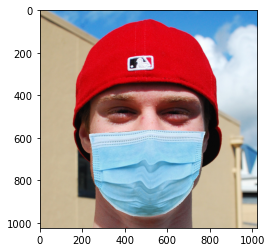

The mask is worn properly


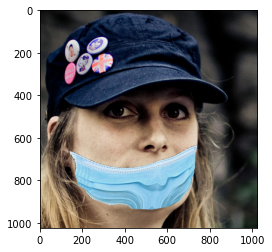

The mask is not worn properly


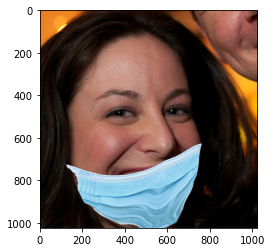

The mask is not worn properly


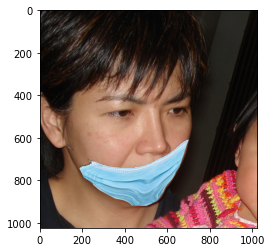

The mask is not worn properly


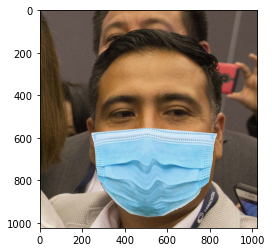

The mask is worn properly


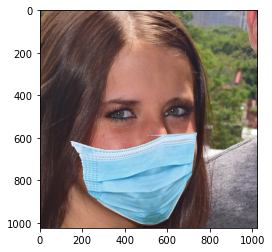

The mask is worn properly


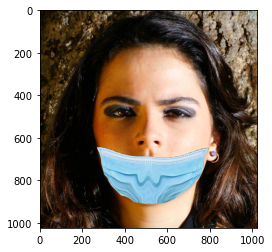

The mask is not worn properly


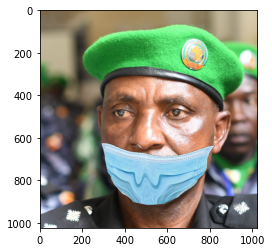

The mask is not worn properly


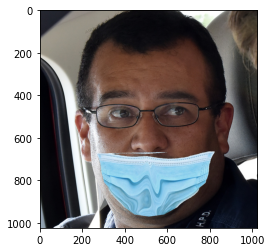

The mask is not worn properly


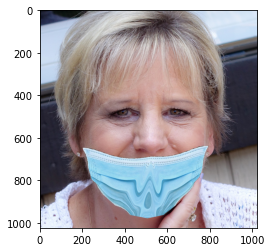

The mask is not worn properly


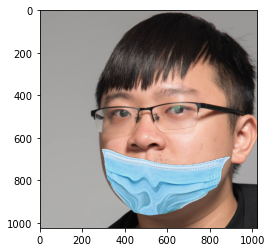

The mask is not worn properly


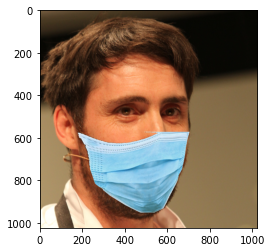

The mask is worn properly


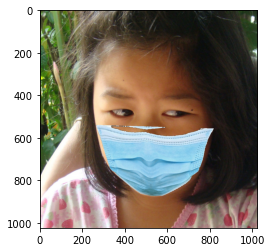

The mask is worn properly


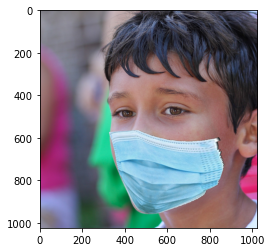

The mask is worn properly


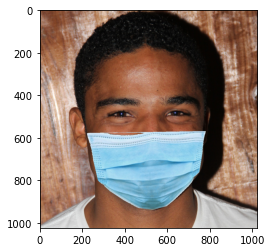

The mask is worn properly


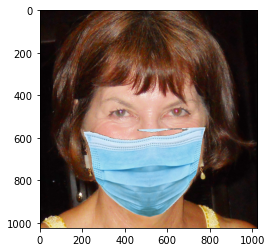

The mask is worn properly


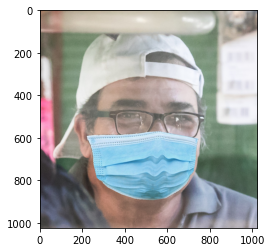

The mask is worn properly


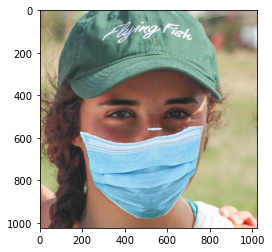

The mask is worn properly


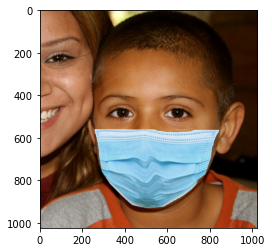

The mask is worn properly


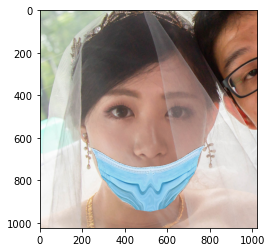

The mask is not worn properly


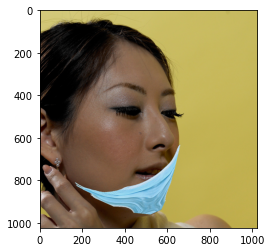

The mask is not worn properly


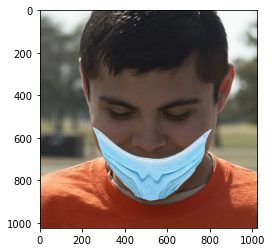

The mask is not worn properly


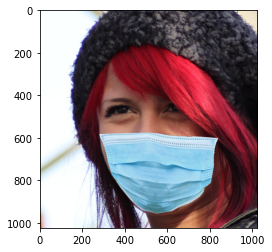

The mask is worn properly


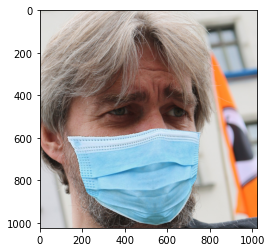

The mask is worn properly


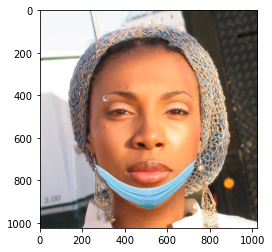

The mask is not worn properly


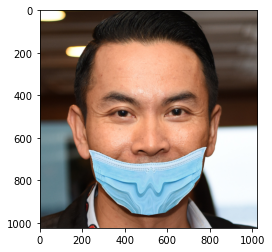

The mask is not worn properly


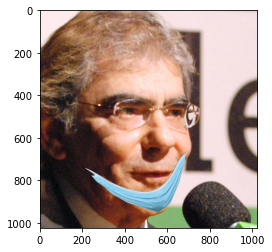

The mask is not worn properly


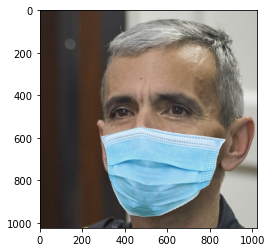

The mask is worn properly


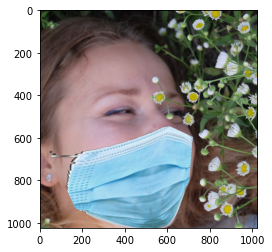

The mask is not worn properly


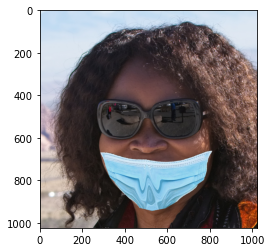

The mask is not worn properly


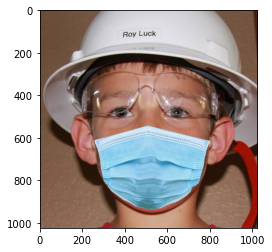

The mask is worn properly


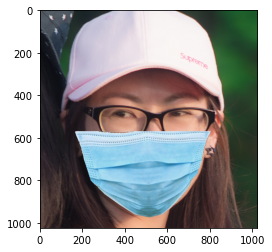

The mask is worn properly


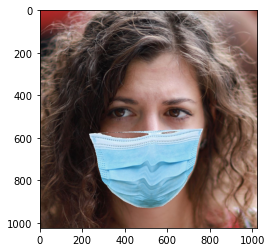

The mask is worn properly


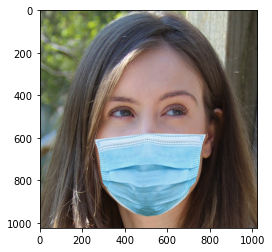

The mask is worn properly


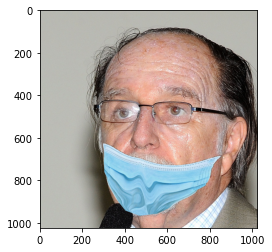

The mask is not worn properly


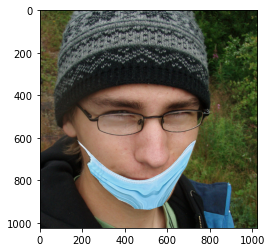

The mask is not worn properly


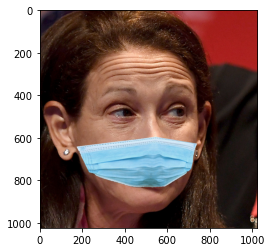

The mask is worn properly


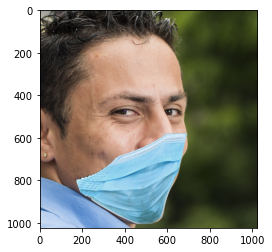

The mask is not worn properly


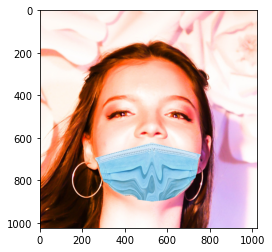

The mask is worn properly


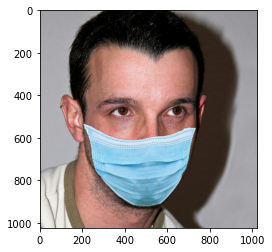

The mask is worn properly


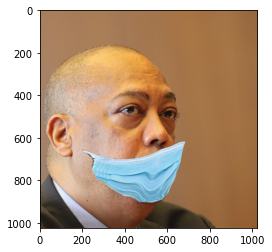

The mask is not worn properly


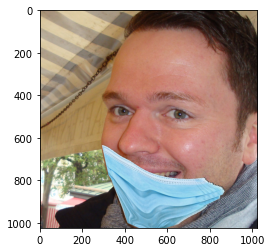

The mask is not worn properly


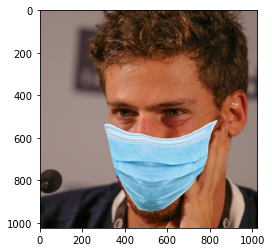

The mask is worn properly


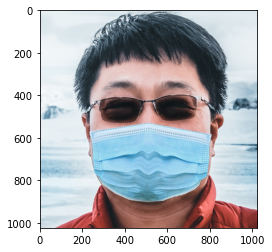

The mask is worn properly


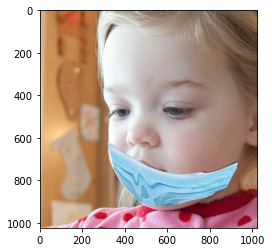

The mask is not worn properly


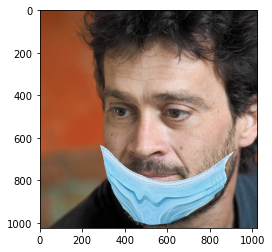

The mask is not worn properly


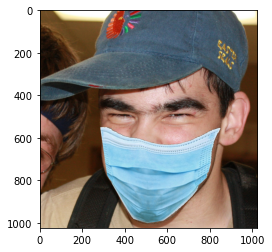

The mask is worn properly


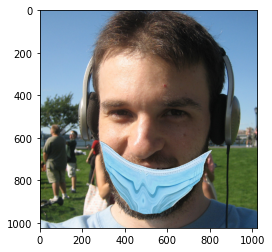

The mask is not worn properly


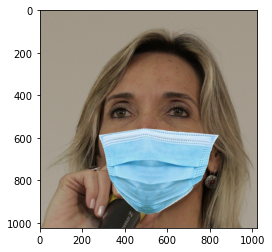

The mask is worn properly


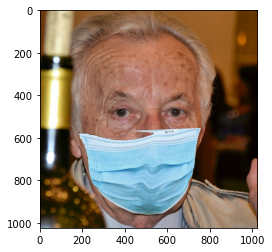

The mask is worn properly


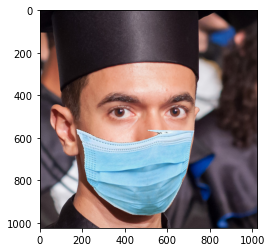

The mask is worn properly


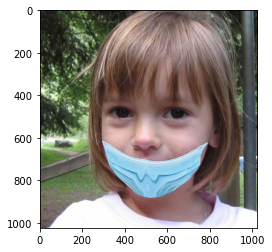

The mask is not worn properly


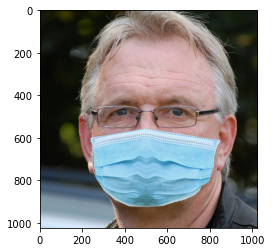

The mask is worn properly


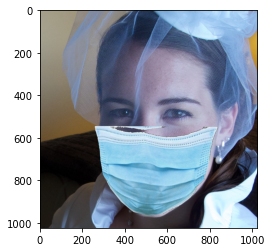

The mask is worn properly


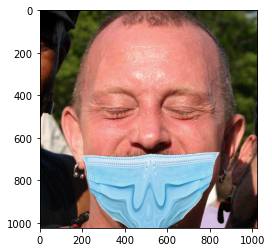

The mask is not worn properly


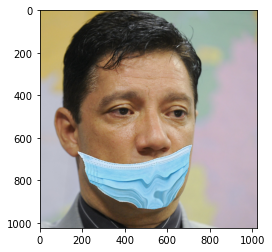

The mask is not worn properly


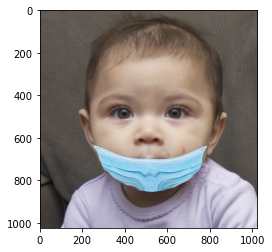

The mask is not worn properly


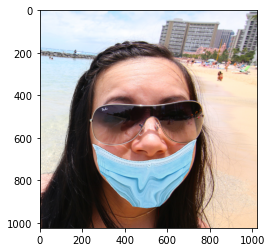

The mask is not worn properly


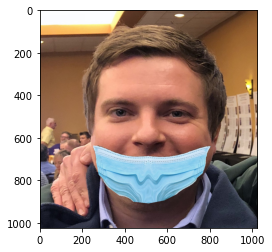

The mask is not worn properly


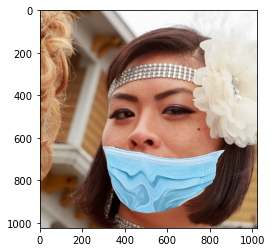

The mask is not worn properly


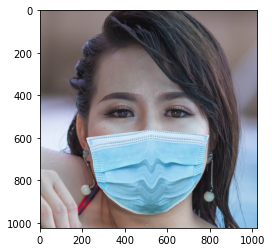

The mask is worn properly


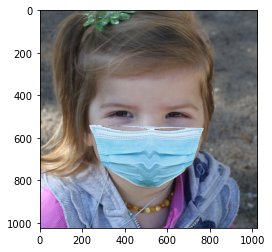

The mask is worn properly


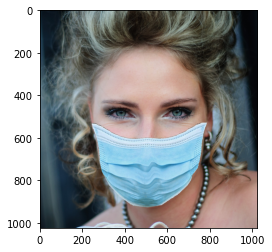

The mask is worn properly


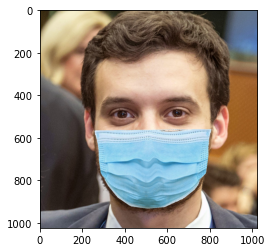

The mask is worn properly


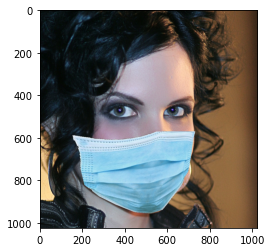

The mask is worn properly


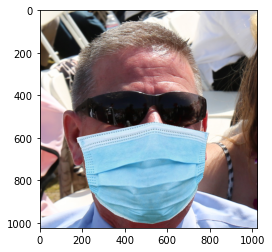

The mask is worn properly


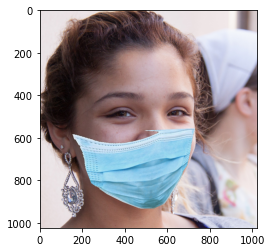

The mask is worn properly


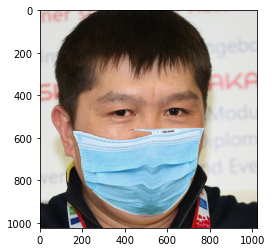

The mask is worn properly


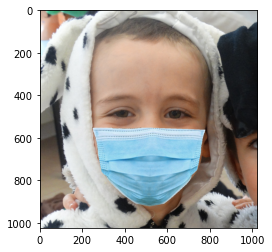

The mask is worn properly


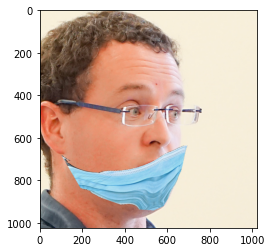

The mask is not worn properly


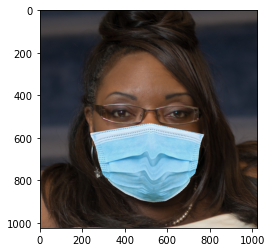

The mask is worn properly


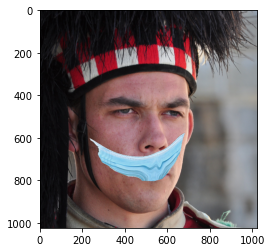

The mask is not worn properly


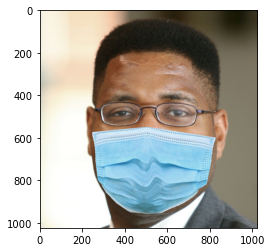

The mask is worn properly


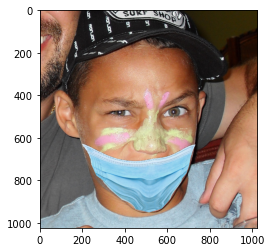

The mask is not worn properly


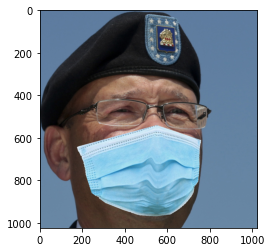

The mask is worn properly


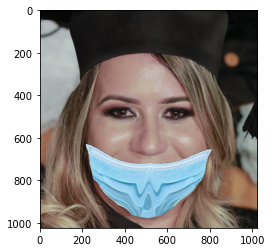

The mask is not worn properly


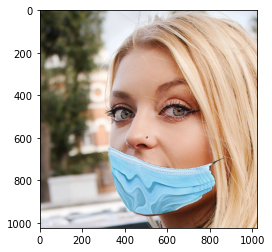

The mask is not worn properly


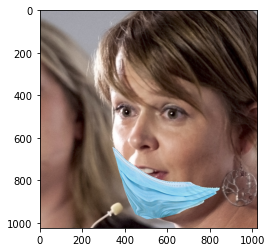

The mask is not worn properly


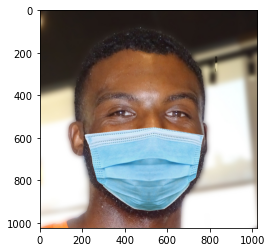

The mask is worn properly


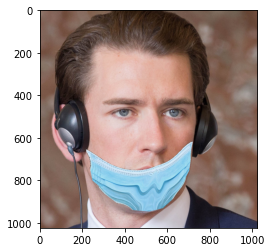

The mask is not worn properly


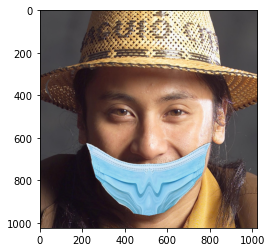

The mask is not worn properly


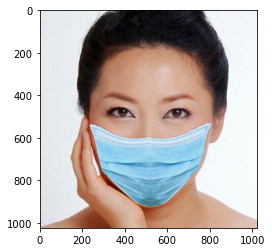

The mask is worn properly


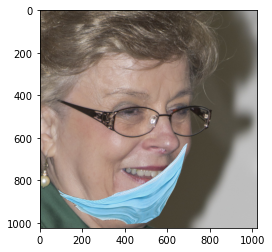

The mask is not worn properly


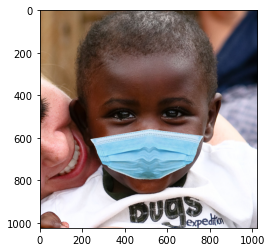

The mask is worn properly


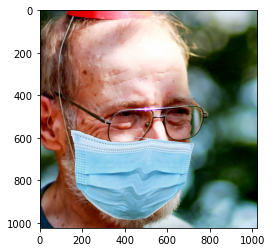

The mask is worn properly


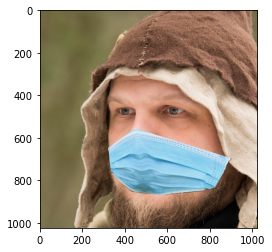

The mask is worn properly


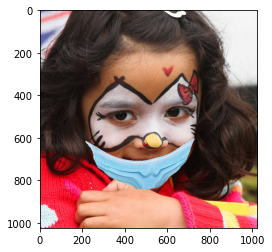

The mask is not worn properly


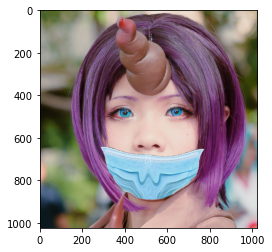

The mask is not worn properly


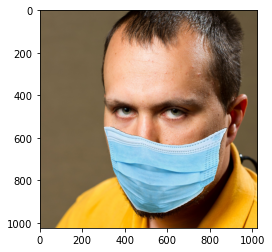

The mask is worn properly


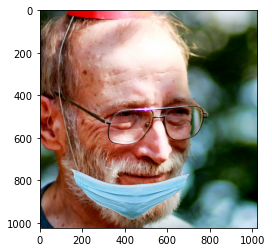

The mask is not worn properly


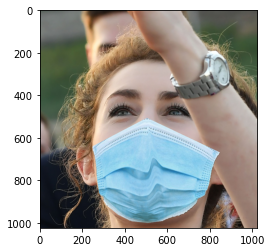

The mask is worn properly


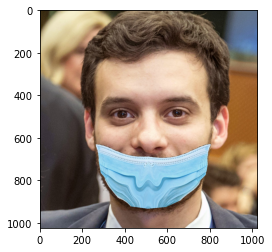

The mask is not worn properly


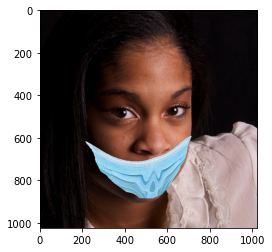

The mask is not worn properly


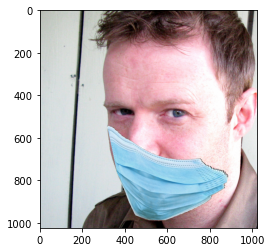

The mask is not worn properly


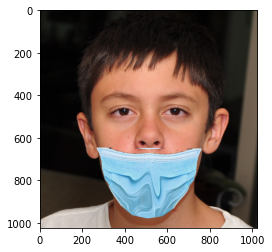

The mask is not worn properly


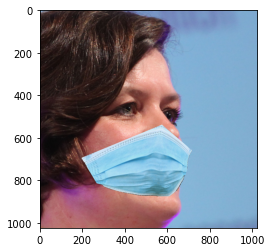

The mask is not worn properly


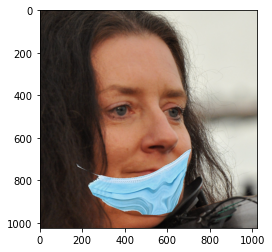

The mask is not worn properly


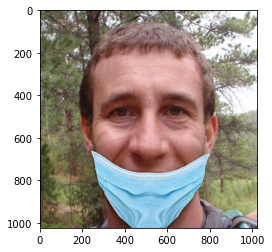

The mask is not worn properly


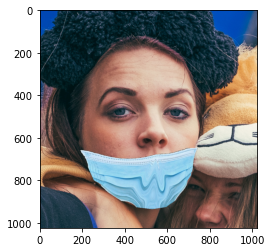

The mask is not worn properly


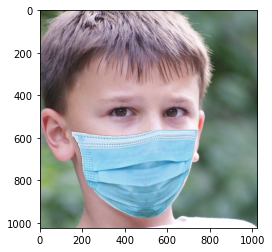

The mask is worn properly


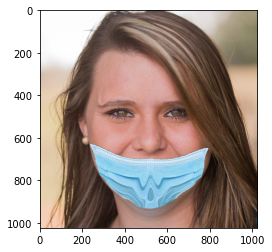

The mask is not worn properly


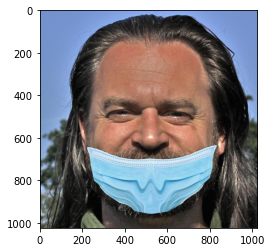

The mask is not worn properly


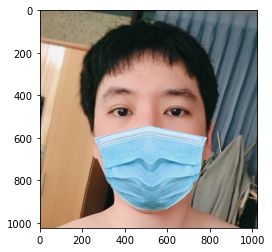

The mask is worn properly


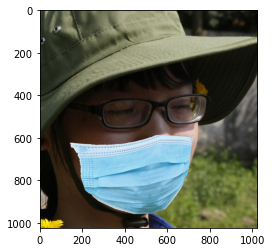

The mask is worn properly


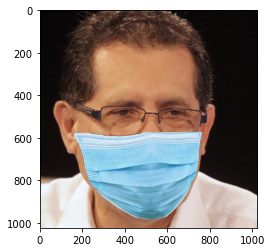

The mask is worn properly


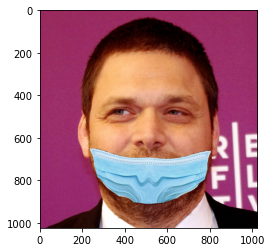

The mask is not worn properly


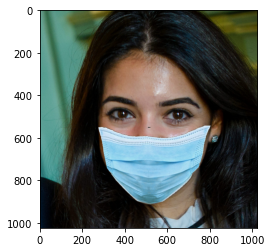

The mask is worn properly


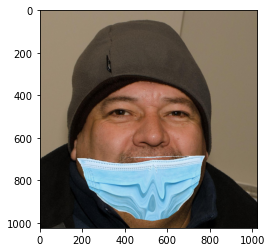

The mask is not worn properly


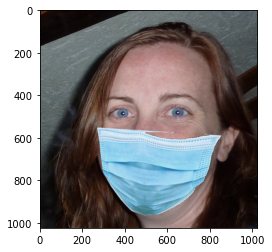

The mask is worn properly


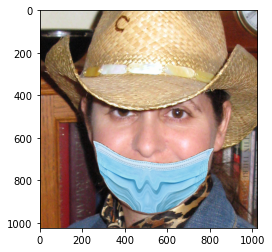

The mask is not worn properly


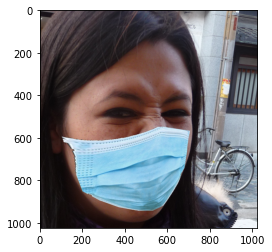

The mask is worn properly


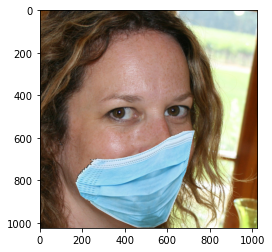

The mask is not worn properly


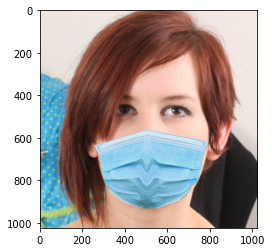

The mask is worn properly


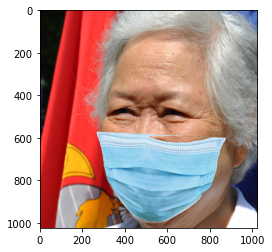

The mask is worn properly


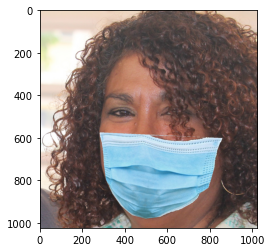

The mask is worn properly


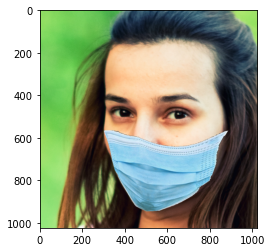

The mask is worn properly


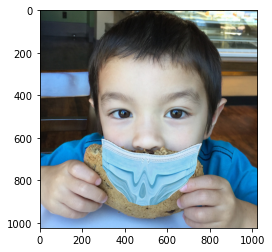

The mask is worn properly


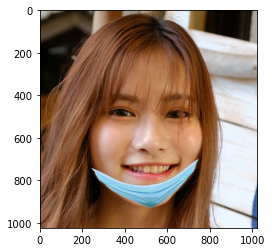

The mask is not worn properly


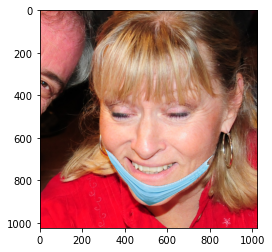

The mask is not worn properly


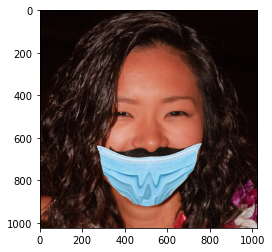

The mask is not worn properly


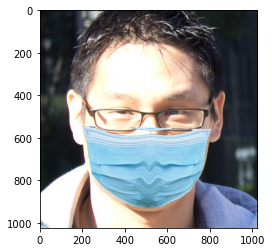

The mask is worn properly


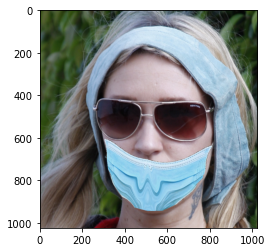

The mask is not worn properly


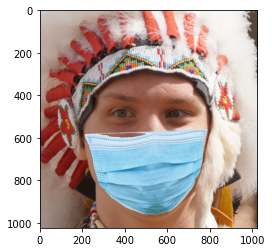

The mask is worn properly


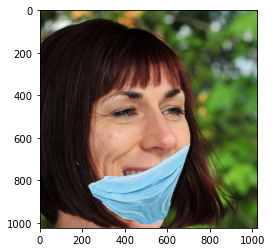

The mask is not worn properly


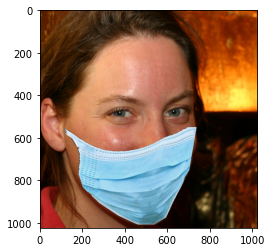

The mask is not worn properly


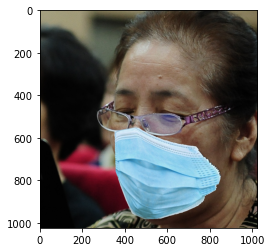

The mask is worn properly


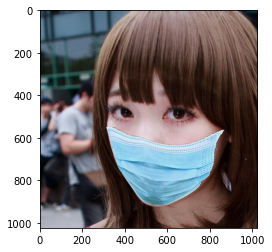

The mask is worn properly


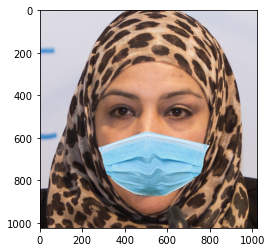

The mask is worn properly


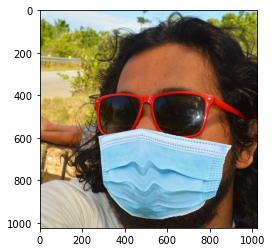

The mask is worn properly


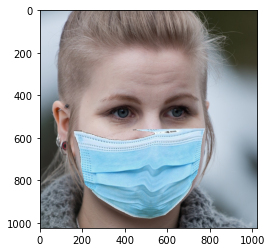

The mask is worn properly


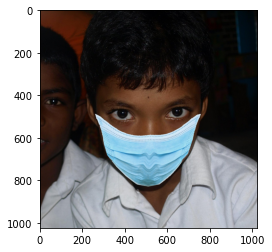

The mask is worn properly


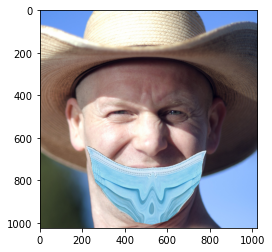

The mask is not worn properly


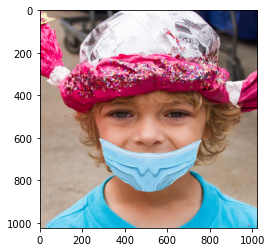

The mask is not worn properly


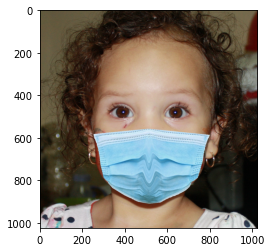

The mask is worn properly


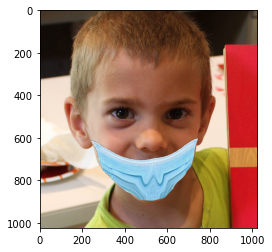

The mask is not worn properly


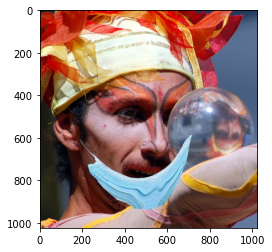

The mask is not worn properly


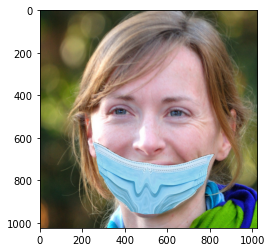

The mask is not worn properly


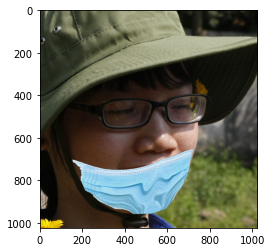

The mask is not worn properly


UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x7fa4f440ccc0>

In [15]:
dir_path = "data/testing_visual"

# How many images you want to see in the visual test
# Increase this number with caution... image processing here takes a long time...
num_images = 100

for file_name in os.listdir(dir_path)[:num_images]:
    img = image.load_img(dir_path+'/'+file_name,target_size=(1024,1024))
    plt.imshow(img)
    plt.show()
    
    X = image.img_to_array(img)
    X = np.expand_dims(X,axis=0)
    images = np.vstack([X])
    
    val = model.predict(images)
    if val == 0:
        print("The mask is not worn properly")
    else:
        print("The mask is worn properly")

When we use a test set of size 500 to calculate our final accuracy, we get a 91.4% accuracy in determining how well our model can predict whether or not an individual is wearing a mask properly.

In [ ]:
# Increase this number with caution... image processing here takes a long time...
# Do not increase this variable past 953 as there are only 953 properly worn masks in the test set
# The test set size will be twice this number
num_test_from_each_class = 250

dir_path_proper = "data/test/proper"
dir_path_improper = "data/test/non_proper"

total = 0
correct = 0

for file_name in os.listdir("data/test/proper")[:num_test_from_each_class]:
    if(total % 25 == 0): print(str(total) + " images processed...")
    total += 1
    img = image.load_img(dir_path_proper+'/'+file_name,target_size=(1024,1024))
    
    X = image.img_to_array(img)
    X = np.expand_dims(X,axis=0)
    images = np.vstack([X])
    
    val = model.predict(images)
    if val == 1:
        correct += 1
        
for file_name in os.listdir("data/test/non_proper")[:num_test_from_each_class]:
    if(total % 25 == 0): print(str(total) + " images processed...")
    total += 1
    img = image.load_img(dir_path_improper+'/'+file_name,target_size=(1024,1024))
    
    X = image.img_to_array(img)
    X = np.expand_dims(X,axis=0)
    images = np.vstack([X])
    
    val = model.predict(images)
    if val == 0:
        correct += 1

print("All " + str(total) + " images processed!")
print("------")  
print("Test set accuracy: " + str(correct/total))

0 images processed...
25 images processed...
50 images processed...
75 images processed...
100 images processed...
125 images processed...
150 images processed...


## Conclusions

Using technology to lead mask enforcement policies during the COVID-19 pandemic can be what leads to a massive drop in cases and potentially even the end of the pandemic. It is widely accepted that masks decrease the community spread of the virus. By having an effective automated system to ensure everyone in a given area is wearing a mask properly, we would be much more efficent in enforcing proper mask wearing than by having humans monitor this manually.

By training a convolutional neural network, we were able to achieve a very high level of accuracy when predicting if people were wearing their masks properly or not. Given the technology constraints from only being able to run this code locally, the potential of such a project feels unlimited. Given enough processing power and storage to handle all 130,000+ images in the original dataset, there is a very realistic chance that a model can be created which could perform at a nearly 100% accuracy on unseen data.

The combination of data and computational analysis can lead to systems which truly improve aspects of our lives tremendously. We hope that this project shows the power that can come with handling and analyzing data properly. Even a task as seemingly complicated as identifying if an individual is wearing a mask properly can be automated given the proper data and data analysis techniques.